<a href="https://colab.research.google.com/github/alshedivat/fedpa/blob/master/fedpa_playground.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Federated Posterior Averaging Playground

This notebook provides an implementation of (generalized, adaptive) federated averaging and posterior averaging in JAX and code for synthetic experiments described in the following paper: https://arxiv.org/abs/2010.05273. 

Additionally, we provide empirical analsysis of the efficiency of different componets of the algorithm (such as MCMC sampling, shrinkage covariance estimation, etc.), effects of the hyperparameters, etc.


## Preliminaries

Connect to GitHub, import and set up Python libraries, etc.

### Pull code from GitHub

In [ ]:
GIT_USERNAME = input("GitHub username: ")
GIT_TOKEN = input("GitHub token: ")
GIT_REPOSITORY = input("GitHub repository: ")
GIT_PATH = f"https://{GIT_TOKEN}@github.com/{GIT_USERNAME}/{GIT_REPOSITORY}.git"

!mkdir -p ./tmp/
!git clone "{GIT_PATH}" ./tmp/
!rm -rf ./federated/
!mv ./tmp/federated/ ./

### Imports

In [2]:
import os
import itertools
import functools

import attr
import numpy as np
import pandas as pd

import jax
from jax import grad, jit, random
import jax.numpy as jnp

from collections import defaultdict
from functools import partial
from itertools import product

import matplotlib
import matplotlib.pyplot as plt

from matplotlib import cm
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.animation as animation

from tqdm.notebook import tqdm

from IPython.display import HTML
import seaborn as sns

In [3]:
# Colab magics.
%reload_ext autoreload
%autoreload 2
%matplotlib inline

In [180]:
# Setup plotting styles.
sns.set_style("white", {"axes.grid": True, "grid.color": ".9", "grid.linestyle": "--"})
matplotlib.rc("axes", titlesize=18, labelsize=16)
matplotlib.rc("legend", fontsize=16)
matplotlib.rc("xtick", labelsize=14)
matplotlib.rc("ytick", labelsize=14)
matplotlib.rc("animation", embed_limit=2**128)

In [5]:
from federated.objectives.quadratic import *
from federated.learning.algorithms import *
from federated.inference.moments import *
from federated.inference.optimization import *
from federated.inference.sampling import *
from federated.utils.plotting import *
from federated.utils.timing import *

## Visualizing simple 2D settings

Befor diving into experiments, let's try to understand how different federated learning algorithms work in 2D settings.

For illustration purposes, we construct a synthetic 2D problem with 2 clients, each of which has their own quadratic objective, $f_i(s) := x^\top A_i x - b_i^\top x + c_i$. Our goal is to optimize the global objective, which is a weighted combination of $f_1(x)$ and $f_2(x)$.

We visualize the difference between local and global optima as well as plot the server state trajectories over the course of federated learning using $\text{MB-SGD}$, $\text{FedAvg}$, and $\text{FedPA}$ algorithms.

### Illustration in 2D (Figure 1)

#### Run experiments

In [6]:
# Monkey-patch Quadratic to make it compatible with SGD + inject some noise.
noise_scale = 1.0

@functools.partial(jit, static_argnums=(0,))
def _grad(_, params, prng_key, x, **kwargs):
  g = grad(Quadratic.eval, argnums=1)(params, x)
  sg = g + noise_scale * random.normal(prng_key, g.shape)
  return sg

Quadratic._grad = _grad

In [7]:
# Define quadratics.
weights = np.array([1., 1.])
q1 = Quadratic(A=np.diag([2, 15]) - 1.5 * np.ones((2, 2)), b=np.array([5, 10]))
q2 = Quadratic(A=np.diag([15, 2]) - 1.5 * np.ones((2, 2)), b=np.array([10, 5]))
q = create_global_quadratic([q1, q2], weights)

# Solve quadratics exactly.
q1_opt, q2_opt, q_opt = q1.solve(), q2.solve(), q.solve()

In [9]:
# Create MB-SGD, FedAvg, and FedPA solvers.

def _client_learning_rate_schedule(_):
  return 10**(-3/2)

def _server_learning_rate_schedule(t):
  return 1.0

def _server_learning_rate_schedule_fedpa(t):
  return 0.1

client_momentum = 0.0
server_momentum = 0.0

mb_sgd_solver = create_mb_sgd(
    client_grads_per_round=1,
    client_learning_rate_schedule=_client_learning_rate_schedule,
    server_learning_rate_schedule=_server_learning_rate_schedule,
    client_momentum=client_momentum,
    server_momentum=server_momentum,
)

fed_avg_solvers = {
    client_steps_per_round: create_fed_avg(
        client_steps_per_round=client_steps_per_round,
        client_learning_rate_schedule=_client_learning_rate_schedule,
        server_learning_rate_schedule=_server_learning_rate_schedule,
        client_momentum=client_momentum,
        server_momentum=server_momentum,
    )
    for client_steps_per_round in [10, 100]
}

fed_pa_exact_solvers = {
    client_samples_per_round: create_post_avg_exact(
        client_samples_per_round=client_samples_per_round,
        server_learning_rate_schedule=_server_learning_rate_schedule_fedpa,
        server_momentum=server_momentum,
        shrinkage_rho=1.0,
        use_dp=False,
    )
    for client_samples_per_round in [10, 100]
}

In [128]:
# Run federated learning experiments.
seeds = range(6)
num_rounds = 30
num_clients_per_round = 2
for o in [q1, q2]:
  o.data = o.params
  o.num_points = 1
  o.batch_size = 1

# Note: we define specific init states for visualization purposes.
init_states = [
  jnp.array([-40., -20.]),
  jnp.array([-40., 40.]),
  jnp.array([0., 60.]),
  jnp.array([60., 40.]),
  jnp.array([60., -20.]),
  jnp.array([20., -20.]),
]

results = pd.DataFrame()
trajectories = defaultdict(list)
dist_to_opt = defaultdict(list)

# MB-SGD.
print("Running MB-SGD...")
for i, seed in enumerate(seeds):
  prng_key = random.PRNGKey(seed)
  prng_key, subkey = random.split(prng_key)
  # init_state = random.normal(subkey, (2,)) * 50.
  init_state = init_states[i]
  traj, _ = mb_sgd_solver(
      client_objectives=[q1, q2],
      init_state=init_state,
      num_rounds=num_rounds,
      num_clients_per_round=num_clients_per_round,
      prng_key=prng_key,
  )
  key = "MB-SGD"
  trajectories[key].append([s.x for s in traj])
  dist_to_opt[key].append([np.linalg.norm(s.x - q_opt) for s in traj])
  results = results.append(pd.DataFrame({
      "step": np.arange(len(traj)),
      "dist_to_opt": np.asarray([np.linalg.norm(s.x - q_opt) for s in traj]),
      "method": [key] * len(traj),
      "seed": [seed] * len(traj),
  }), ignore_index=True)

# FedAvg.
print("Running FedAvg...")
for steps, solver in fed_avg_solvers.items():
  for i, seed in enumerate(seeds):
    prng_key = random.PRNGKey(seed)
    prng_key, subkey = random.split(prng_key)
    # init_state = random.normal(subkey, (2,)) * 50.
    init_state = init_states[i]
    traj, _ = solver(
      client_objectives=[q1, q2],
      init_state=init_state,
      num_rounds=num_rounds,
      num_clients_per_round=num_clients_per_round,
      prng_key=prng_key,
    )
    key = f"FedAvg - {steps} steps"
    trajectories[key].append([s.x for s in traj])
    dist_to_opt[key].append([np.linalg.norm(s.x - q_opt) for s in traj])
    results = results.append(pd.DataFrame({
        "step": np.arange(len(traj)),
        "dist_to_opt": np.asarray([np.linalg.norm(s.x - q_opt) for s in traj]),
        "method": [key] * len(traj),
        "seed": [seed] * len(traj),
    }), ignore_index=True)

# FedPA.
print("Running FedPA...")
for samples, solver in fed_pa_exact_solvers.items():
  for i, seed in enumerate(seeds):
    prng_key = random.PRNGKey(seed)
    prng_key, subkey = random.split(prng_key)
    # init_state = random.normal(subkey, (2,)) * 50.
    init_state = init_states[i]
    traj, _ = solver(
      client_objectives=[q1, q2],
      init_state=init_state,
      num_rounds=num_rounds,
      num_clients_per_round=num_clients_per_round,
      prng_key=prng_key,
    )
    key = f"FedPA - {samples} samples"
    trajectories[key].append([s.x for s in traj])
    dist_to_opt[key].append([np.linalg.norm(s.x - q_opt) for s in traj])
    results = results.append(pd.DataFrame({
        "step": np.arange(len(traj)),
        "dist_to_opt": np.asarray([np.linalg.norm(s.x - q_opt) for s in traj]),
        "method": [key] * len(traj),
        "seed": [seed] * len(traj),
    }), ignore_index=True)

print("Done.")

Running MB-SGD...
Running FedAvg...
Running FedPA...
Done.


#### Generate Figure 1

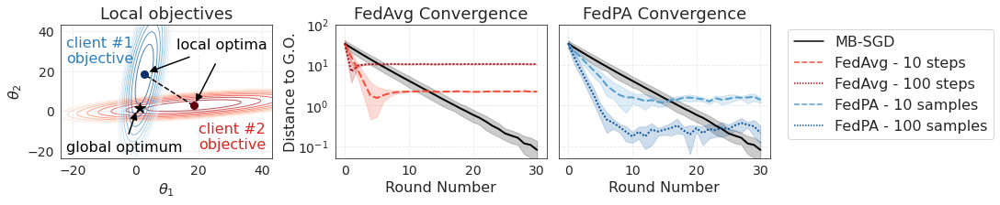

In [53]:
fig, axes = plt.subplots(1, 3, figsize=(15, 3), constrained_layout=True)

# Plot quadratics.
ax = axes[0]
ax.set_title("Local objectives")
_, (xlim, ylim) = plot_objective_contours(
    ax=ax,
    objectives=[q1, q2],
    global_objective=q,
    mesh_margins=(25., 25.),
    num_levels=10,
    max_level_coeff=0.02,
    contour_alpha=0.7,
    contour_linewidth=1.0,
    contour_cmaps=("Reds_r", "Blues_r"),
)
ax.set_xlabel(r"$\theta_1$")
ax.set_ylabel(r"$\theta_2$")

# Annotations.
ax.plot(*zip(q1_opt, q2_opt), "--", color="black")
ax.plot(*q1_opt, marker='o', color=plt.get_cmap("Reds_r")(0), markersize=8)
ax.plot(*q2_opt, marker='o', color=plt.get_cmap("Blues_r")(0), markersize=8)
ax.plot(*q_opt, marker='*', color="black", markersize=12)

ax = axes[0]
ax.text(-22, 24, "client #1\nobjective", color=plt.get_cmap("Blues_r")(0.3), fontsize=16)
ax.text(20, -19, "client #2\nobjective", color=plt.get_cmap("Reds_r")(0.3), fontsize=16)
ax.annotate(
    "global optimum",
    xy=q_opt + np.array([-1.0, -1.0]),
    xytext=(-22, -20),
    fontsize=16,
    color="black",
    arrowprops=dict(
        arrowstyle="-|>",
        color="black",
        linewidth=1.5,
    ),
    bbox=dict(pad=5, facecolor="none", edgecolor="none"),
)
ax.annotate(
    "local optima",
    xy=q1_opt + np.array([0.5, 1.0]),
    xytext=(13, 28),
    fontsize=16,
    color="white",
    arrowprops=dict(
        arrowstyle="-|>",
        color="black",
        linewidth=1.5,
    ),
    bbox=dict(pad=5, facecolor="none", edgecolor="none"),
)
ax.annotate(
    "local optima",
    xy=q2_opt + np.array([1.0, 1.0]),
    xytext=(13, 31),
    fontsize=16,
    color="black",
    arrowprops=dict(
        arrowstyle="-|>",
        color="black",
        linewidth=1.5,
    ),
    bbox=dict(pad=5, facecolor="none", edgecolor="none"),
)

# Plot FedAvg trajectories.
ax = axes[1]
ax.clear()
ax.set_title("FedAvg Convergence")
df = results[~results["method"].str.startswith("FedPA")]
palette = sns.color_palette("Reds")
palette = [(0., 0., 0.)] + [palette[3], palette[-1]]
sns.lineplot(
    data=df,
    x="step",
    y="dist_to_opt",
    hue="method",
    style="method",
    legend="full",
    palette=palette,
    linewidth=2,
    ax=ax,
)
ax.set_ylim([0.05, 100])
ax.set_yscale("log")
# ax.set_ylabel("Distance to Global Optimum", labelpad=0)
ax.set_ylabel("Distance to G.O.", labelpad=0)
ax.set_xlabel("Round Number")
handles_fed_avg, labels_fed_avg = ax.get_legend_handles_labels()
ax.get_legend().remove()

# Plot FedPA trajectories.
ax = axes[2]
ax.clear()
ax.set_title("FedPA Convergence")
df = results[~results["method"].str.startswith("FedAvg")]
palette = sns.color_palette("Blues")
palette = [(0., 0., 0.)] + [palette[3], palette[-1]]
sns.lineplot(
    data=df,
    x="step",
    y="dist_to_opt",
    hue="method",
    style="method",
    legend="full",
    palette=palette,
    linewidth=2,
    ax=ax
)
ax.set_ylim([0.05, 100])
ax.set_yscale("log")
ax.set_yticklabels([])
ax.set_ylabel(None)
ax.set_xlabel("Round Number")
handles_fed_pa, labels_fed_pa = ax.get_legend_handles_labels()
ax.get_legend().remove()

handles = handles_fed_avg + handles_fed_pa[1:]
labels = labels_fed_avg + labels_fed_pa[1:]
lgd = ax.legend(handles, labels, loc=2, bbox_to_anchor=(1.05, 1.02))

fig.savefig("illustration2d.pdf", bbox_extra_artists=(lgd,),)
fig

### Animation of the Convergence Behaviors in 2D

Instead of a static plot, we build an animation of the previous 2D example.

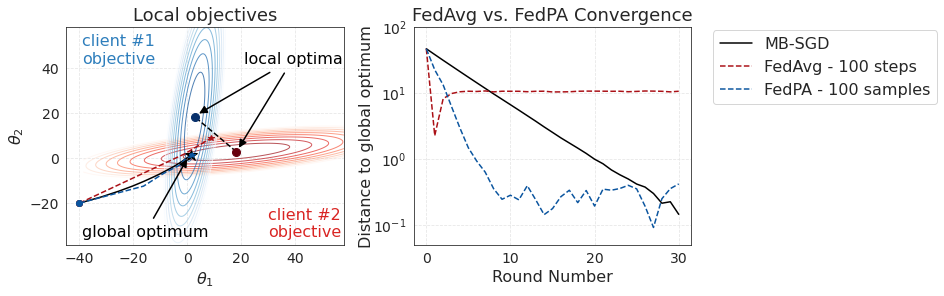

In [181]:
# Plot quadratics.
fig, axes = plt.subplots(1, 2, figsize=(13, 4), constrained_layout=True)
palette = [(0., 0., 0.), sns.color_palette("Reds")[5], sns.color_palette("Blues")[5]]

ax = axes[0]
ax.set_title("Local objectives")
_, (xlim, ylim) = plot_objective_contours(
    ax=ax,
    objectives=[q1, q2],
    global_objective=q,
    mesh_margins=(40., 40.),
    num_levels=10,
    max_level_coeff=0.02,
    contour_alpha=0.7,
    contour_linewidth=1.0,
    contour_cmaps=("Reds_r", "Blues_r"),
)
ax.set_xlabel(r"$\theta_1$")
ax.set_ylabel(r"$\theta_2$")

# Annotations.
ax.plot(*zip(q1_opt, q2_opt), "--", color="black")
ax.plot(*q1_opt, marker='o', color=plt.get_cmap("Reds_r")(0), markersize=8)
ax.plot(*q2_opt, marker='o', color=plt.get_cmap("Blues_r")(0), markersize=8)
ax.plot(*q_opt, marker='*', color="black", markersize=12)

ax = axes[0]
ax.text(-39, 42, "client #1\nobjective", color=plt.get_cmap("Blues_r")(0.3), fontsize=16)
ax.text(30, -35, "client #2\nobjective", color=plt.get_cmap("Reds_r")(0.3), fontsize=16)
ax.annotate(
    "global optimum",
    xy=q_opt + np.array([-1.0, -1.0]),
    xytext=(-39, -35),
    fontsize=16,
    color="black",
    arrowprops=dict(
        arrowstyle="-|>",
        color="black",
        linewidth=1.5,
    ),
    bbox=dict(pad=5, facecolor="none", edgecolor="none"),
)
ax.annotate(
    "local optima",
    xy=q1_opt + np.array([0.5, 1.0]),
    xytext=(21, 42),
    fontsize=16,
    color="white",
    arrowprops=dict(
        arrowstyle="-|>",
        color="black",
        linewidth=1.5,
    ),
    bbox=dict(pad=5, facecolor="none", edgecolor="none"),
)
ax.annotate(
    "local optima",
    xy=q2_opt + np.array([1.0, 1.0]),
    xytext=(21, 42),
    fontsize=16,
    color="black",
    arrowprops=dict(
        arrowstyle="-|>",
        color="black",
        linewidth=1.5,
    ),
    bbox=dict(pad=5, facecolor="none", edgecolor="none"),
)

# Trajectory plots.
traj_plots = {}
line_types = ["-", "--", "--"]
keys = ["MB-SGD", "FedAvg - 100 steps", "FedPA - 100 samples"]
for key, color, lt in zip(keys, palette, line_types):
  traj = trajectories[key][0]
  traj_start, = ax.plot(*traj[0], 'o', color=color)
  traj_end, = ax.plot(*traj[-1], '*', color=color)
  traj_plot, = ax.plot(*np.stack(traj).T, lt, color=color)
  traj_plots[key] = (traj_plot, traj_start, traj_end)


# Distance to optimum plots.
ax = axes[1]
dist_plots = {}
line_types = ["-", "--", "--"]
keys = ["MB-SGD", "FedAvg - 100 steps", "FedPA - 100 samples"]
for key, color, lt in zip(keys, palette, line_types):
  steps = np.arange(len(dist_to_opt[key][0]))
  dists = np.asarray(dist_to_opt[key][0])
  dist_plot, = ax.plot(steps, dists, lt, color=color)
  dist_plots[key] = dist_plot
ax.set_ylim([0.05, 100])
ax.set_yscale("log")
ax.set_ylim([0.05, 100])
ax.set_yscale("log")
ax.set_ylabel("Distance to global optimum", labelpad=-1)
ax.set_xlabel("Round Number")
ax.set_title("FedAvg vs. FedPA Convergence")
lgd = ax.legend(keys, loc=2, bbox_to_anchor=(1.05, 1.02))

pass

In [182]:
# Initialization and animation functions.
def init():
  handles = []
  for traj_plot, traj_start, traj_end in traj_plots.values():
    traj_plot.set_data([], [])
    traj_start.set_data([], [])
    traj_end.set_data([], [])
    handles.extend([traj_plot, traj_start, traj_end])
  for dist_plot in dist_plots.values():
    dist_plot.set_data([], [])
    handles.append(dist_plot)
  return tuple(handles)


def animate(i):
  handles = []
  for key, color, lt in zip(keys, palette, line_types):
    if key not in traj_plots:
      continue
    k, r = i // num_rounds, i % num_rounds
    traj = trajectories[key][k][:r+1]
    dists = dist_to_opt[key][k][:r+1]

    # Update trajectory plots.
    traj_plot, traj_start, traj_end = traj_plots[key]
    traj_start.set_data(*traj[0])
    traj_end.set_data(*traj[-1])
    traj_plot.set_data(*np.stack(traj).T)

    # Distance to global optimum plots.
    dist_plots[key].set_data(np.arange(r + 1), np.asarray(dists))
    handles.extend([traj_plot, traj_start, traj_end, dist_plot])

  return handles

In [183]:
# Create an animation.
anim = animation.FuncAnimation(
    fig,
    animate,
    init_func=init,
    frames=30 * 6,
    interval=300,
    repeat_delay=500,
    blit=True)
writer = animation.PillowWriter(fps=5)
anim.save("fedavg-vs-fedpa.gif", writer=writer)
HTML(anim.to_jshtml())

## Analysis of the Local Computational Cost (Section 4)

In [ ]:
# Create objective functions.
dims = 10000
n_samples = 500
batch_size = 10
num_objectives = 1

client_objectives = create_random_least_squares(
  num_objectives=num_objectives,
  batch_size=batch_size,
  n_features=dims,
  n_samples=(n_samples,),
  bias_scale=1.0,
  noise=0.5,
  lam=1e-1,
)

In [ ]:
# Run all solvers.
prng_key = random.PRNGKey(0)
global_obj = create_global_least_squares(client_objectives)
init_state = 10 * random.normal(prng_key, (global_obj.dim,))
num_clients_per_round = 1

def _client_learning_rate_schedule(_):
  return 0.1

fedavg_num_steps_per_epoch = 100
fedavg_num_epochs_per_round = 5

In [ ]:
client_iasg_burnin_steps = fedavg_num_steps_per_epoch
client_iasg_avg_steps = fedavg_num_steps_per_epoch
client_iasg_learning_rate = 0.1
client_iasg_discard_steps = 0
client_iasg_momentum = 0.0
rho_fn = lambda _: 1.0

posterior_sampler = IterateAveragedStochasticGradientSampler(
    avg_steps=client_iasg_avg_steps,
    burnin_steps=client_iasg_burnin_steps,
    learning_rate=client_iasg_learning_rate,
    discard_steps=client_iasg_discard_steps,
    momentum=client_iasg_momentum,
)
moment_estimator = ShrinkageMomentEstimator(rho_fn=rho_fn)

In [ ]:
# Time FedAvg delta computation.
%%timeit
compute_fed_avg_delta(
    objective=client_objectives[0],
    init_state=init_state,
    prng_key=prng_key,
    num_steps=fedavg_num_steps_per_epoch * fedavg_num_epochs_per_round,
    learning_rate_schedule=_client_learning_rate_schedule,
).block_until_ready()

10 loops, best of 3: 80.1 ms per loop


In [ ]:
# Time exact FedPA delta computation.
%%timeit
compute_post_avg_delta(
    objective=client_objectives[0],
    init_state=init_state,
    prng_key=prng_key,
    num_samples=3,
    sampler=posterior_sampler,
    moment_estimator=moment_estimator,
).block_until_ready()

1 loop, best of 3: 797 ms per loop


In [ ]:
# Time DP-based FedPA delta computation.
%%timeit
compute_post_avg_delta_dp(
    objective=client_objectives[0],
    init_state=init_state,
    prng_key=prng_key,
    num_samples=3,
    sampler=posterior_sampler,
    rho_fn=rho_fn,
).block_until_ready()

10 loops, best of 3: 93.5 ms per loop


## Empirical analysis of the bias-variance tradeoffs in quadratic settings (Appendix A.1)

In this part, we empirically analyze the bias-variance tradeoffs for $\text{FedAvg}$ vs. $\text{FedPA}$ as functions their parameters.
Note that the bias and variance are computed with respect to the exact client deltas $\Delta := \Sigma^{-1}(\theta - \mu)$.
These deltas correspond to the best estimates that clients can possibly obtain and send to the server to ensure global convergence (in quadratic settings or under the Laplace approximation).

In [ ]:
# Create objective functions.
dims = [10, 100, 1000]
n_samples = 500
batch_size = 10
num_objectives = 5

client_objectives = {}
for d in dims:
  client_objectives[d] = create_random_least_squares(
      num_objectives=num_objectives,
      batch_size=batch_size,
      n_features=d,
      n_samples=(n_samples,),
      bias_scale=1.0,
      noise=0.5,
      lam=1e-1,
  )

In [ ]:
def compute_bias_variance(
    deltas: jnp.ndarray, exact_delta: jnp.ndarray
) -> jnp.ndarray:
    """Computes the bias and variance of the deltas w.r.t. the exact gradient."""
    deltas_mean = jnp.mean(deltas, axis=0)
    deltas_cov = jnp.cov(deltas, rowvar=False)
    coeff = jnp.linalg.norm(deltas_mean) / jnp.linalg.norm(exact_delta)
    bias = jnp.linalg.norm(deltas_mean - exact_delta * coeff)
    variance = jnp.linalg.norm(deltas_cov)
    return bias, variance


def compute_deltas(
    compute_delta_fn: Callable,
    objective: StochasticObjective,
    repetitions: int,
    init_state: jnp.ndarray,
    prng_key: jnp.ndarray,
) -> jnp.ndarray:
    deltas = []
    for j in range(repetitions):
        prng_key, subkey = random.split(prng_key)
        deltas.append(
            compute_delta_fn(objective, init_state=init_state, prng_key=subkey)
        )
    return jnp.stack(deltas)

### $\text{FedAvg}$: Bias-Variance vs. number of local steps

In [ ]:
# Run experiments for FedAvg.
seed = 0
dims = [10, 100, 1000]
local_steps = {
    10: [1, 5, 10, 15, 20, 30, 40, 60, 80, 100],
    100: [1, 5, 10, 15, 20, 30, 40, 60, 80, 100, 150, 200],
    1000: [1, 5, 10, 20, 50, 100, 200, 500, 1000, 1500, 2000, 3000, 4000, 6000],
}
num_init_points = 5
num_repetitions = 10
results_fedavg = pd.DataFrame()
prng_key = random.PRNGKey(seed)

learning_rate_schedules = {
    10: lambda _: 0.1,
    100: lambda _: 0.1,
    1000: lambda _: 0.01,
}

for d in tqdm(dims, desc="Dimensions"):
  for i, obj in enumerate(tqdm(client_objectives[d], desc="Objectives", leave=False)):
    obj_opt = obj.solve()
    for j in tqdm(range(num_init_points), desc="Initial points", leave=False):
      prng_key, subkey = random.split(prng_key)
      init_state = obj_opt + 10 * random.normal(subkey, (obj.dim,))
      exact_delta = compute_exact_delta(obj, init_state)
      for steps in tqdm(local_steps[d], desc="Local steps", leave=False):
        prng_key, subkey = random.split(prng_key)
        fed_avg_deltas = compute_deltas(
            compute_delta_fn=functools.partial(
                compute_fed_avg_delta,
                num_steps=steps,
                learning_rate_schedule=learning_rate_schedules[d],
            ),
            objective=obj,
            repetitions=num_repetitions,
            init_state=init_state,
            prng_key=subkey,
        )
        fed_avg_bias, fed_avg_var = compute_bias_variance(
            fed_avg_deltas, exact_delta
        )
        results_fedavg = results_fedavg.append(pd.DataFrame({
            "dim": [d],
            "bias": [float(fed_avg_bias)],
            "variance": [float(fed_avg_var)],
            "local_steps": [steps],
            "method": ["FedAvg"],
            "objective_id": [i],
            "init_point_id": [j],
        }), ignore_index=True)

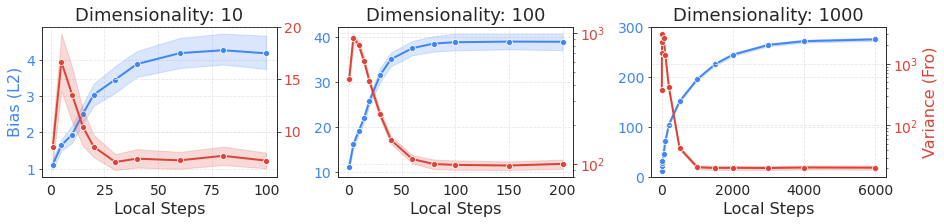

In [ ]:
# FedAvg bias-variance plots.
fig, axes = plt.subplots(1, 3, figsize=(13, 3), constrained_layout=True)

dims = [10, 100, 1000]
# palette = sns.color_palette()
blue_color = "#4285F4"
red_color = "#DB4437"
palette = [blue_color, red_color]

for d, ax in zip(dims, axes):
  df = results_fedavg[results_fedavg["dim"] == d]
  ax.set_title(f"Dimensionality: {d}")

  # Bias.
  sns.lineplot(
      data=df,
      x="local_steps",
      y="bias",
      marker="o",
      linewidth=2,
      color=palette[0],
      ax=ax
  )
  ax.set_xlabel("Local Steps")
  ax.tick_params(axis='y', labelcolor=palette[0])
  if d == 10:
    ax.set_ylabel("Bias (L2)", color=palette[0])
  else:
    ax.set_ylabel(None)
  if d == 1000:
    ax.set_ylim([0, 300])

  # Variance.
  ax = ax.twinx()
  sns.lineplot(
      data=df,
      x="local_steps",
      y="variance",
      marker="o",
      linewidth=2,
      color=palette[1],
      ax=ax
  )
  ax.tick_params(axis='y', labelcolor=palette[1])
  if d != 10:
    ax.set_yscale("log")
    # ax.set_ylim([5, 25])
  if d == 1000:
    ax.set_ylabel("Variance (Fro)", color=palette[1])
  else:
    ax.set_ylabel(None)

fig.savefig("fedavg-bias-variance.pdf")

### $\text{FedPA}$: Bias-Variance vs. number of local samples

#### Run experiments

In [ ]:
# Run experiments for FedPA.
seed = 0
dims = [10, 100, 1000]
local_samples = {
    10: [1, 5, 10, 20, 50, 100, 200, 500],
    100: [1, 5, 10, 20, 50, 100, 200, 500],
    1000: [1, 5, 10, 20, 50, 100, 200, 500],
}
num_init_points = 5
num_repetitions = 10
results_fedpa = pd.DataFrame()
prng_key = random.PRNGKey(seed)

sampler = ExactQuadraticSampler()
rhos = {
    10: [0.001, 0.0025, 0.005, 0.01, 0.025, 0.05, 0.1],
    100: [0.001, 0.0025, 0.005, 0.01, 0.025, 0.05, 0.1],
    1000: [0.0001, 0.00025, 0.0005, 0.001, 0.0025, 0.005, 0.01],
}

for d in tqdm(dims, desc="Dimensions"):
  for i, obj in enumerate(tqdm(client_objectives[d], desc="Objectives", leave=False)):
    obj_opt = obj.solve()
    for j in tqdm(range(num_init_points), desc="Initial points", leave=False):
      prng_key, subkey = random.split(prng_key)
      init_state = obj_opt + 10 * random.normal(subkey, (obj.dim,))
      exact_delta = compute_exact_delta(obj, init_state)
      for samples in tqdm(local_samples[d], desc="Local samples", leave=False):
        prng_key, subkey = random.split(prng_key)
        for rho in tqdm(rhos[d], desc="Shrinkage", leave=False):
          moment_estimator = ShrinkageMomentEstimator(rho=rho)
          fedpa_deltas = compute_deltas(
              compute_delta_fn=functools.partial(
                  compute_post_avg_delta,
                  num_samples=samples,
                  sampler=sampler,
                  moment_estimator=moment_estimator,
              ),
              objective=obj,
              repetitions=num_repetitions,
              init_state=init_state,
              prng_key=subkey,
          )
          fedpa_bias, fedpa_var = compute_bias_variance(
              fedpa_deltas, exact_delta
          )
          results_fedpa = results_fedpa.append(pd.DataFrame({
              "dim": [d],
              "bias": [float(fedpa_bias)],
              "variance": [float(fedpa_var)],
              "local_steps": [samples * 50],
              "shrinkage_rho": [rho],
              "method": ["FedPA"],
              "objective_id": [i],
              "init_point_id": [j],
          }), ignore_index=True)

#### Generate figures

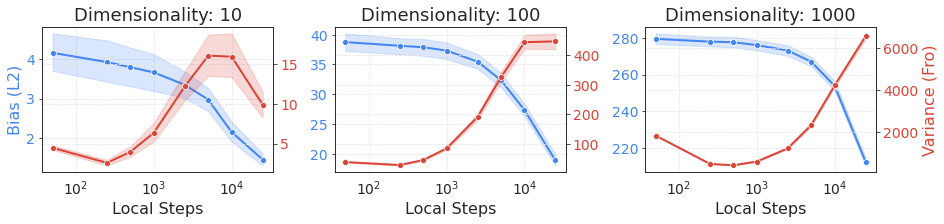

In [ ]:
# FedPA bias-variance plots.
fig, axes = plt.subplots(1, 3, figsize=(13, 3), constrained_layout=True)

dims = [10, 100, 1000]
# palette = sns.color_palette()
blue_color = "#4285F4"
red_color = "#DB4437"
palette = [blue_color, red_color]
rho = {10: 0.01, 100: 0.005, 1000: 0.001}

for d, ax in zip(dims, axes):
  df = results_fedpa[results_fedpa["dim"] == d]
  df = df[df["shrinkage_rho"] == rho[d]]
  ax.set_title(f"Dimensionality: {d}")

  # Bias.
  sns.lineplot(
      data=df,
      x="local_steps",
      y="bias",
      marker="o",
      linewidth=2,
      color=palette[0],
      ax=ax
  )
  ax.set_xlabel("Local Steps")
  ax.tick_params(axis='y', labelcolor=palette[0])
  if d == 10:
    ax.set_ylabel("Bias (L2)", color=palette[0])
  else:
    ax.set_ylabel(None)

  # Variance.
  ax = ax.twinx()
  sns.lineplot(
      data=df,
      x="local_steps",
      y="variance",
      marker="o",
      linewidth=2,
      color=palette[1],
      ax=ax
  )
  ax.set_xscale("log")
  ax.tick_params(axis='y', labelcolor=palette[1])
  if d == 1000:
    ax.set_ylabel("Variance (Fro)", color=palette[1])
  else:
    ax.set_ylabel(None)

fig.savefig("fedpa-bias-variance-steps.pdf")

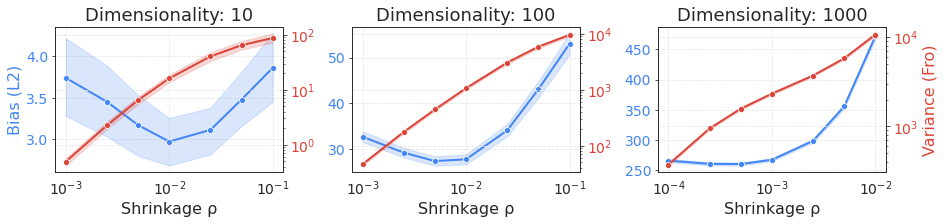

In [ ]:
# FedPA bias-variance plots.
fig, axes = plt.subplots(1, 3, figsize=(13, 3), constrained_layout=True)

# palette = sns.color_palette()
blue_color = "#4285F4"
red_color = "#DB4437"
palette = [blue_color, red_color]
steps = {10: 5000, 100: 10000, 1000: 5000}

for d, ax in zip(dims, axes):
  df = results_fedpa[results_fedpa["dim"] == d]
  df = df[df["local_steps"] == steps[d]]
  ax.set_title(f"Dimensionality: {d}")

  # Bias.
  sns.lineplot(
      data=df,
      x="shrinkage_rho",
      y="bias",
      marker="o",
      linewidth=2,
      color=palette[0],
      ax=ax
  )
  ax.set_xlabel("Shrinkage ρ")
  ax.tick_params(axis='y', labelcolor=palette[0])
  if d == 10:
    ax.set_ylabel("Bias (L2)", color=palette[0])
  else:
    ax.set_ylabel(None)

  # Variance.
  ax = ax.twinx()
  sns.lineplot(
      data=df,
      x="shrinkage_rho",
      y="variance",
      marker="o",
      linewidth=2,
      color=palette[1],
      ax=ax
  )
  ax.set_xscale("log")
  ax.set_yscale("log")
  ax.tick_params(axis='y', labelcolor=palette[1])
  if d == 1000:
    ax.set_ylabel("Variance (Fro)", color=palette[1])
  else:
    ax.set_ylabel(None)

fig.savefig("fedpa-bias-variance-rho.pdf")

## Empirical analysis of the quality of IASG samples in quadratic settings (Appendix A.2)

In this part, we analyze the quality of IASG-produced samples in terms of the effective sample size (ESS) measure as a function of the number of burn-in steps, steps per sample, and the learning rate on quadratic problems of different dimensionality.

#### Run experiments

In [ ]:
# Create objective functions.
dims = [10, 100, 1000]
n_samples = 500
batch_size = 10
num_objectives = 5

client_objectives = {}
for d in dims:
  client_objectives[d] = create_random_least_squares(
      num_objectives=num_objectives,
      batch_size=batch_size,
      n_features=d,
      n_samples=(n_samples,),
      bias_scale=1.0,
      noise=0.5
  )

In [ ]:
# Define IASG hyperparameter grid.
epoch = int(n_samples / batch_size)
avg_steps = np.arange(1, 6) * epoch
burnin_steps = {
    10: (np.arange(0, 5) * epoch).tolist(),
    100: (np.arange(0, 5) * epoch).tolist() + [300, 400],
    1000: (np.arange(0, 5) * epoch).tolist() + [300, 400, 600, 800],
}
learning_rates = {
    10: np.logspace(-2, 0, 9).tolist(),
    100: np.logspace(-3, -1, 9).tolist(),
    1000: np.logspace(-4, -2, 9).tolist(),
}
lr_best = {10: 0.1, 100: 0.1, 1000: 0.01}


def compute_ess_results(avg, bs, lr, objectives, results, prng_key, num_samples):
  sampler = IASG(avg_steps=avg, burnin_steps=bs, learning_rate=lr)
  ess = []
  for o in objectives:
    prng_key, subkey = random.split(prng_key)
    samples = sampler.sample(
        objective=o,
        prng_key=subkey,
        num_samples=num_samples,
    )
    ess.append(compute_ess(o, samples))
  return results.append(pd.DataFrame({
      "dim": [d] * len(ess),
      "avg_steps": [avg] * len(ess),
      "burnin_steps": [bs] * len(ess),
      "learning_rate": [lr] * len(ess),
      "ess": ess,
      "seed": np.arange(len(ess)),
  }), ignore_index=True)

In [ ]:
# Compute ESS for each objective and each sampler.
seed = 0
num_samples = 100
results = pd.DataFrame()
prng_key = random.PRNGKey(seed)

for d in tqdm(dims, desc="Dimensions"):
  objectives = client_objectives[d]
  for avg in tqdm(avg_steps, desc="Steps per sample", leave=False):
    if avg == epoch:
      for bs in tqdm(burnin_steps[d], desc="Burn-in steps", leave=False):
        if bs == 2 * epoch:
          for lr in tqdm(learning_rates[d], desc="Learning rate", leave=False):
            prng_key, subkey = random.split(prng_key)
            results = compute_ess_results(
                avg, bs, lr, objectives, results, subkey, num_samples
            )
        else:
          lr = lr_best[d]
          prng_key, subkey = random.split(prng_key)
          results = compute_ess_results(
              avg, bs, lr, objectives, results, subkey, num_samples
          )
    else:
      bs, lr = 2 * epoch, lr_best[d]
      prng_key, subkey = random.split(prng_key)
      results = compute_ess_results(
          avg, bs, lr, objectives, results, subkey, num_samples
      )

#### Generate figures

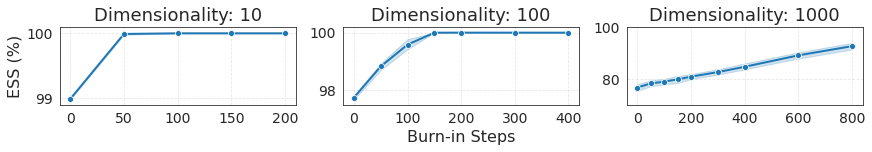

In [ ]:
fig, axes = plt.subplots(1, 3, figsize=(12, 2), constrained_layout=True)

blue_color = "#4285F4"
palette = [blue_color]

# ESS vs. burn-in steps.
for dim, ax in zip(dims, axes):
  ax.set_title(f"Dimensionality: {dim}")
  df = results[results["dim"] == dim]
  df = df[df["avg_steps"] == epoch]
  df = df[df["learning_rate"] == lr_best[dim]]
  df["ess"] = np.asarray(df["ess"], dtype=np.float32)
  sns.lineplot(
      data=df,
      x="burnin_steps",
      y="ess",
      marker="o",
      palette=palette,
      linewidth=2,
      ax=ax
  )
  if dim == 10:
    ax.set_ylabel("ESS (%)")
    ax.set_ylim([98.9, 100.1])
  else:
    ax.set_ylabel(None)
  if dim ==  100:
    ax.set_xlabel("Burn-in Steps")
    ax.set_ylim([97.5, 100.2])
  else:
    ax.set_xlabel(None)
  if dim == 1000:
    ax.set_ylim([70, 100])

fig.savefig("ess-burnin.pdf")

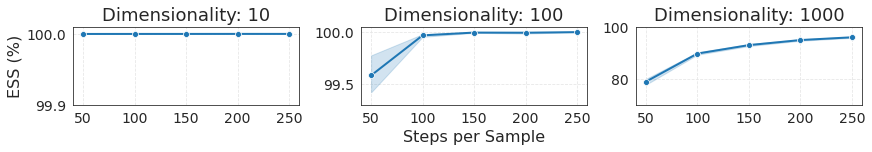

In [ ]:
fig, axes = plt.subplots(1, 3, figsize=(12, 2), constrained_layout=True)

blue_color = "#4285F4"
palette = [blue_color]

# ESS vs. steps per round
for dim, ax in zip(dims, axes):
  ax.set_title(f"Dimensionality: {dim}")
  df = results[results["dim"] == dim]
  df = df[df["burnin_steps"] == 2 * epoch]
  df = df[df["learning_rate"] == lr_best[dim]]
  df["ess"] = np.asarray(df["ess"], dtype=np.float32)
  sns.lineplot(
      data=df,
      x="avg_steps",
      y="ess",
      marker="o",
      palette=palette,
      linewidth=2,
      ax=ax
  )
  if dim == 10:
    ax.set_ylabel("ESS (%)")
    ax.set_ylim([99.9, 100.01])
  else:
    ax.set_ylabel(None)
  if dim ==  100:
    ax.set_xlabel("Steps per Sample")
    ax.set_ylim([99.3, 100.05])
  else:
    ax.set_xlabel(None)
  if dim == 1000:
    ax.set_ylim([70, 100])

fig.savefig("ess-steps-per-sample.pdf")

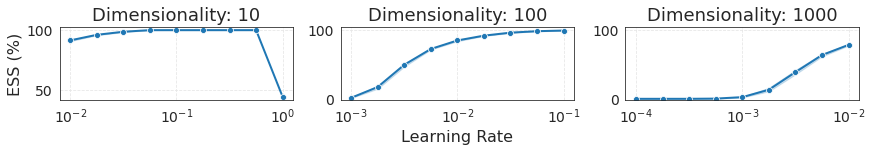

In [ ]:
fig, axes = plt.subplots(1, 3, figsize=(12, 2), constrained_layout=True)

blue_color = "#4285F4"
palette = [blue_color]

# ESS vs. learning rate
for dim, ax in zip(dims, axes):
  ax.set_title(f"Dimensionality: {dim}")
  df = results[results["dim"] == dim]
  df = df[df["avg_steps"] == epoch]
  df = df[df["burnin_steps"] == 2 * epoch]
  df["ess"] = np.asarray(df["ess"], dtype=np.float32)
  sns.lineplot(
      data=df,
      x="learning_rate",
      y="ess",
      marker="o",
      palette=palette,
      linewidth=2,
      ax=ax
  )
  ax.set_xscale("log")
  if dim == 10:
    ax.set_ylabel("ESS (%)")
  else:
    ax.set_ylabel(None)
  if dim ==  100:
    ax.set_xlabel("Learning Rate")
    ax.set_ylim([-1, 105])
  else:
    ax.set_xlabel(None)
  if dim == 1000:
    ax.set_ylim([-1, 105])

fig.savefig("ess-lr.pdf")